In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import os
import plotly.express as px
from folium.plugins import HeatMap
import folium

In [2]:
# Loading files
files = os.listdir(r':\Data Analysis\Uber Data Analysis\uber-pickups-in-new-york-city')[-7:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
files.remove('uber-raw-data-janjune-15.csv')

In [4]:
# Creating dataframe with data from files

path = r':\Data Analysis\Uber Data Analysis\uber-pickups-in-new-york-city'
final = pd.DataFrame()
for file in files:
    df = pd.read_csv(path+"/"+file,encoding='utf-8')
    final = pd.concat([final,df])

In [5]:
final.shape

(4534327, 4)

In [6]:
df = final.copy()
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [7]:
df['Date/Time'] = pd.to_datetime(df['Date/Time'],format="%m/%d/%Y %H:%M:%S")
df['Weekday'] = df['Date/Time'].dt.day_name()
df['Day'] = df['Date/Time'].dt.day
df['Hours'] = df['Date/Time'].dt.hour
df['Minute'] = df['Date/Time'].dt.minute
df['Month'] = df['Date/Time'].dt.month
df['Month_name'] = df['Date/Time'].dt.strftime('%B')

In [8]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Hours,Minute,Month,Month_name
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,0,11,4,April
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,0,17,4,April
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,0,21,4,April
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,0,28,4,April
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,0,33,4,April


In [9]:
df.dtypes

Date/Time     datetime64[ns]
Lat                  float64
Lon                  float64
Base                  object
Weekday               object
Day                    int64
Hours                  int64
Minute                 int64
Month                  int64
Month_name            object
dtype: object

In [10]:
# weekly rides (Maximum rides on Thursday and Friday)

px.bar(x=df.Weekday.value_counts().index,y=df.Weekday.value_counts(),
       labels={'x':'Weekday','y':'Number of rides'},title='Weekly rides')

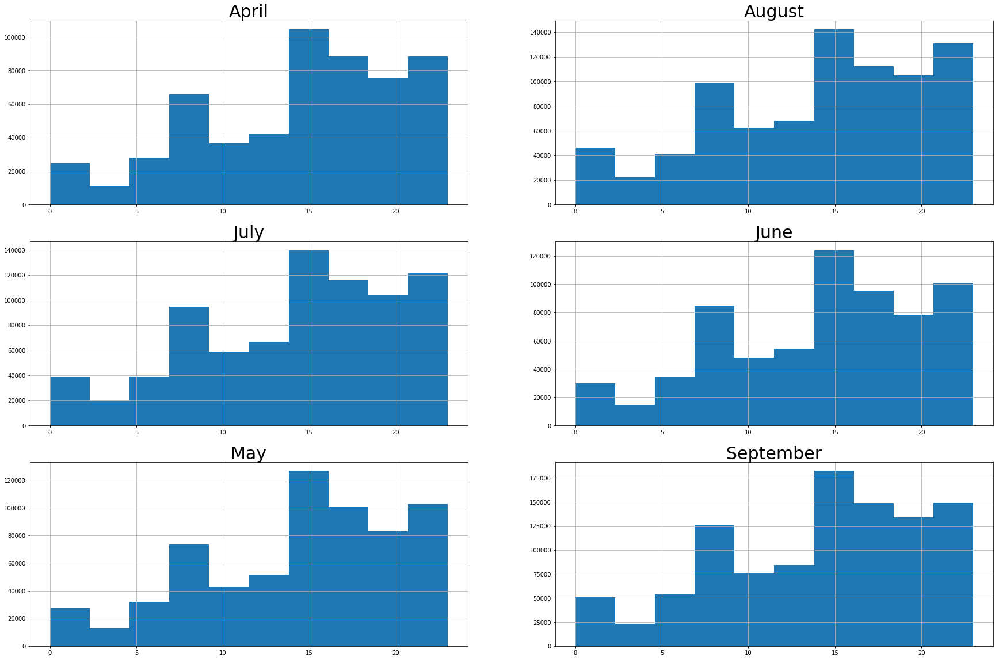

In [11]:
# Every month hourly rides (High number of rides booked in the evening time)

plt.figure(figsize=(30,20))
for i,month in enumerate(df['Month_name'].unique()):
    plt.subplot(3,2,i+1)
    df[df['Month_name']==month]['Hours'].hist()
    plt.title(month,fontsize=30)

In [12]:
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [13]:
# Monthly rides (Maximum number of rides in september)

trace1 = go.Bar(x=df.Month_name.value_counts(ascending=True).index,
      y=df.Month_name.value_counts(ascending=True),
      name = 'Priority')
iplot([trace1])

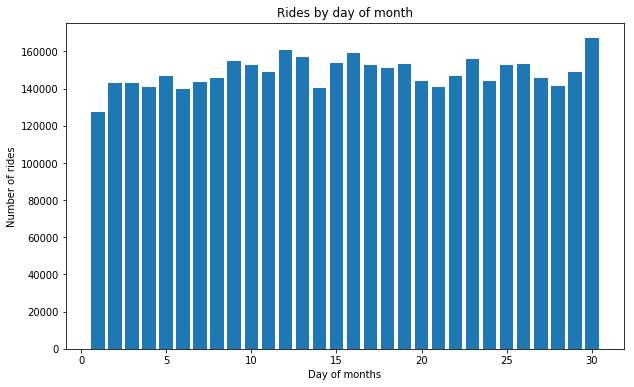

In [14]:
# Total Number of rides based on day of months

plt.figure(figsize=(10,6))
plt.hist(df['Day'],bins=30,rwidth=0.8,range=(0.5,30.5))
plt.xlabel('Day of months')
plt.ylabel('Number of rides')
plt.title('Rides by day of month')
plt.show()

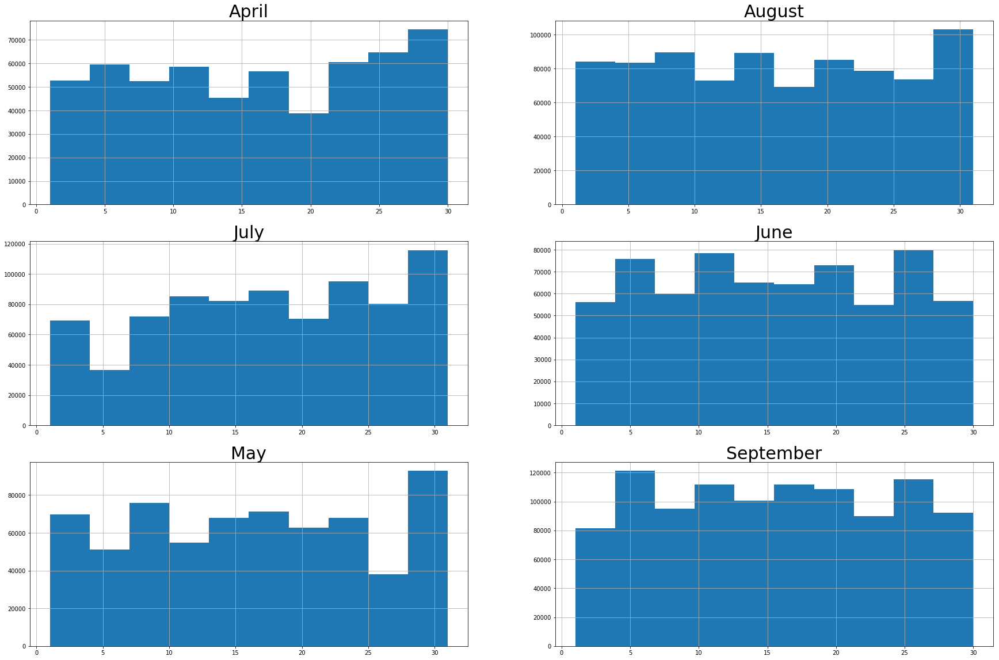

In [15]:
# Daily rides of every month

plt.figure(figsize=(30,20))
for i,month in enumerate(df['Month_name'].unique()):
    plt.subplot(3,2,i+1)
    df[df['Month_name']==month]['Day'].hist()
    plt.title(month,fontsize=30)

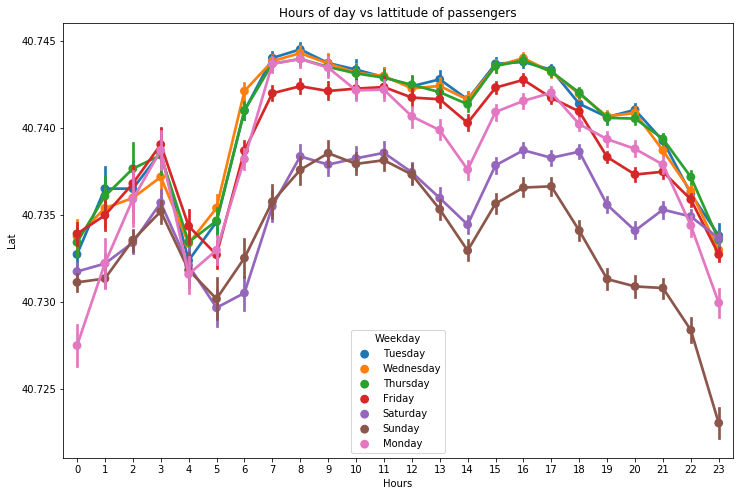

In [16]:
# Hourly rides on weekday at different lattitudes

plt.figure(figsize=(12,8))
ax = sns.pointplot(x='Hours',y='Lat',data=df,hue='Weekday')
ax.set_title('Hours of day vs lattitude of passengers')
plt.show()

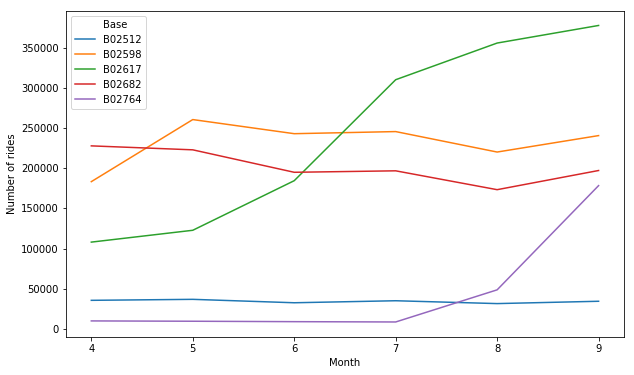

In [17]:
# Demand of vehicles over a period of time

base = df.groupby(['Base','Month'])['Date/Time'].count().reset_index()
plt.figure(figsize=(10,6))
sns.lineplot(x='Month',y='Date/Time',data=base,hue='Base')
plt.ylabel('Number of rides')
plt.show()

In [18]:
by_cross = df.groupby(['Weekday','Hours'])['Date/Time'].count()
pivot = by_cross.unstack()
pivot

Hours,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


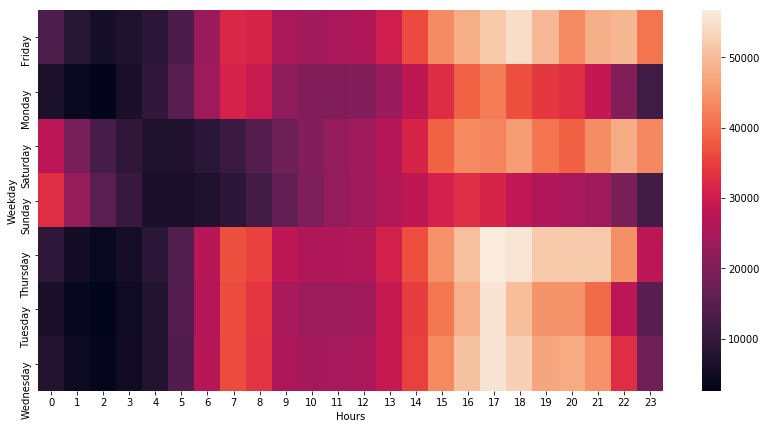

In [19]:
# More rides are in the evening and less rides on early hours

plt.figure(figsize=(14,7))
sns.heatmap(pivot)
plt.show()

In [20]:
def count_rows(rows):
    return len(rows)
def heatmap(col1,col2):
    by_cross = df.groupby([col1,col2]).apply(count_rows)
    pivot = by_cross.unstack()
    plt.figure(figsize=(14,7))
    sns.heatmap(pivot)

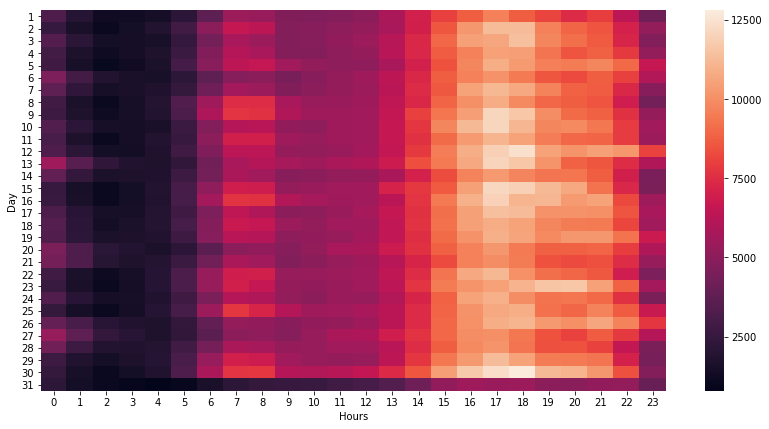

In [21]:
# uber has very less number of rides in late night of every day
heatmap('Day','Hours')

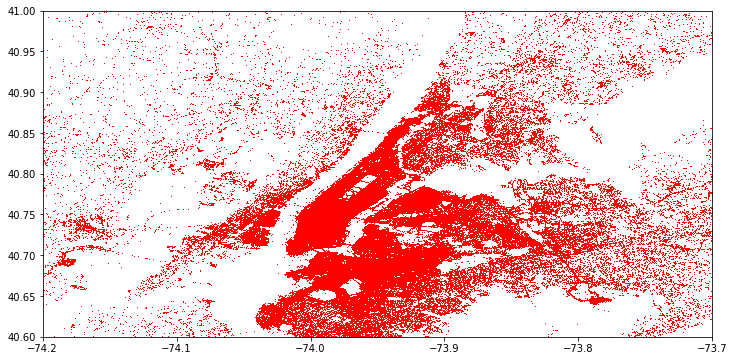

In [22]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)
plt.show()

In [23]:
df_out = df[df['Weekday']=='Sunday']
rush = df_out.groupby(['Lat','Lon'])['Weekday'].count().reset_index()
rush.columns=['Lat','Lon','No of Rides']
rush.head()

,Lat,Lon,No of Rides
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [24]:
basemap = folium.Map()
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap

In [25]:
def plot(df,day):
    basemap = folium.Map()
    df_out = df[df['Weekday']==day]
    HeatMap(df_out.groupby(['Lat','Lon'])['Weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [26]:
plot(df,'Friday')

In [27]:
uber_15 = pd.read_csv(r':\Data Analysis\Uber Data Analysis\uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv')

In [28]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [29]:
uber_15['Pickup_date'] = pd.to_datetime(uber_15['Pickup_date'],format="%Y-%m-%d %H:%M:%S")

In [30]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [31]:
uber_15['Weekday'] = uber_15.Pickup_date.dt.day_name()
uber_15['Day'] = uber_15.Pickup_date.dt.day
uber_15['Month'] = uber_15.Pickup_date.dt.month
uber_15['Hours'] = uber_15.Pickup_date.dt.hour
uber_15['Minute'] = uber_15.Pickup_date.dt.minute
uber_15['Month_name'] = uber_15.Pickup_date.dt.strftime('%B')

In [32]:
# Maximum number of rides are booked in June

px.bar(x= uber_15.Month.value_counts().index,
       y= uber_15.Month.value_counts())

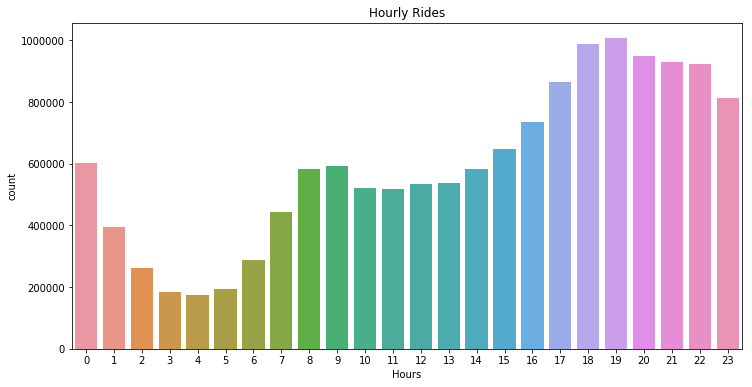

In [33]:
# Overall Hourly rides in six months

plt.figure(figsize=(12,6))
sns.countplot(uber_15.Hours)
plt.title('Hourly Rides')
plt.show()

In [34]:
summary = uber_15.groupby(['Weekday','Hours'])['Pickup_date'].count().reset_index()
summary.columns = ['Weekday','Hours','Number of rides']

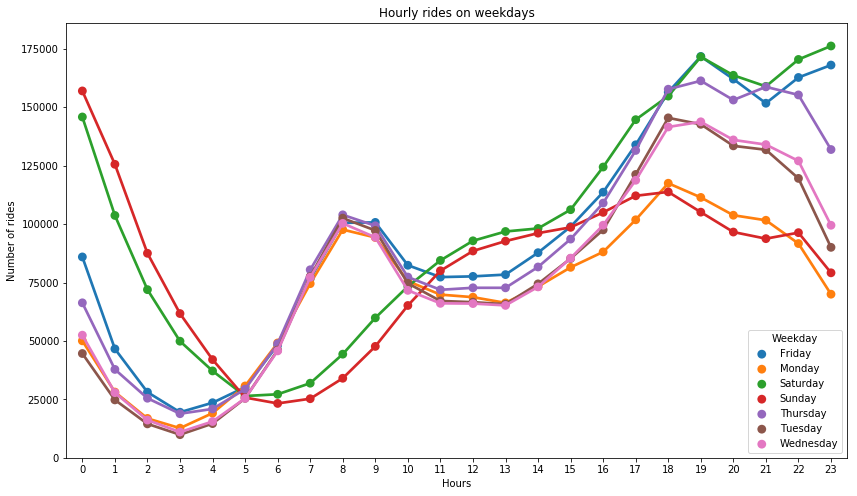

In [35]:
# The demand for uber on friday and saturday are high at evening time

plt.figure(figsize=(14,8))
sns.pointplot(x='Hours',y='Number of rides',data=summary,hue='Weekday')
plt.title('Hourly rides on weekdays')
plt.show()

In [36]:
uber_foil = pd.read_csv(r':\Data Analysis\Uber Data Analysis\uber-pickups-in-new-york-city\Uber-Jan-Feb-FOIL.csv')
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [37]:
uber_foil.shape

(354, 4)

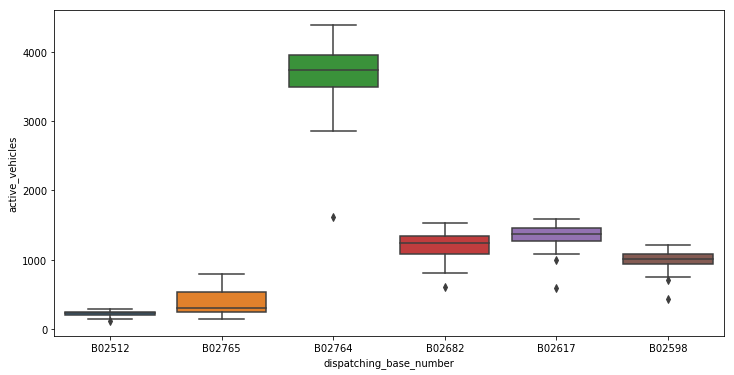

In [38]:
plt.figure(figsize=(12,6))
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil)
plt.show()

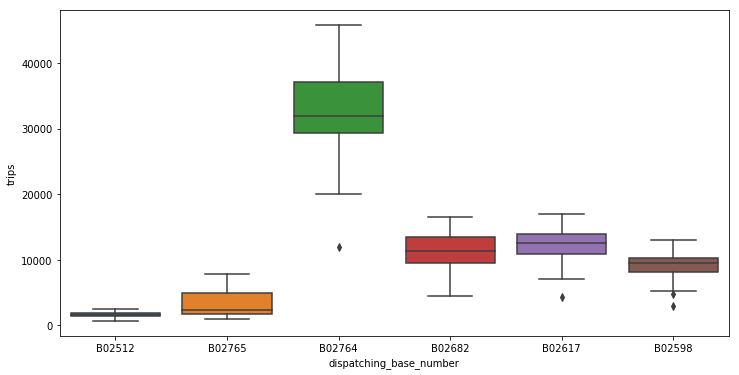

In [39]:
plt.figure(figsize=(12,6))
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil)
plt.show()

In [40]:
uber_foil['trips/vehicle'] = uber_foil['trips']/uber_foil['active_vehicles']
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


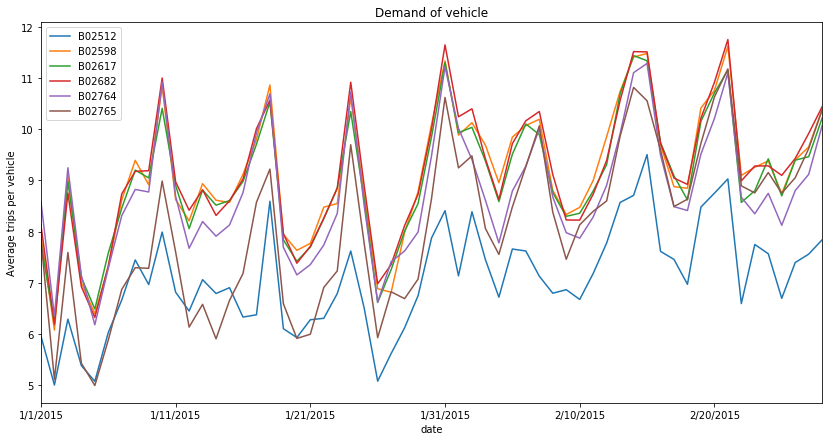

In [41]:
plt.figure(figsize=(14,7))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('Average trips per vehicle')
plt.title('Demand of vehicle')
plt.legend()
plt.show()